In [1]:
import cv2
import numpy as np
from skimage.exposure import cumulative_distribution
from matplotlib import pyplot as plt

In [2]:
def cdf(hist):
    o = range(0,256)
    for x in range(0,256):
        o[x] = hist[x][0]
    for x in range(1,256):
        o[x] = o[x] + o[x-1]
    return o

def cal_trans(c, c_t, im):
    pixels = np.arange(256)
    new_pixels = np.interp(c, c_t, pixels) 
    im = (np.reshape(new_pixels[im.ravel()], im.shape)).astype(np.uint8)
    return im

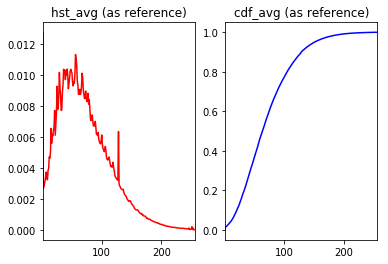

In [3]:
histr_sum = 0
num_pic = 184  # number of pictures
for i in range(1001, 1185):  # 평균 histogram을 얻기 위함.
    img = cv2.imread('data-test/'+str(i)+'_002.tif',0)
    histr = cv2.calcHist([img],[0],None,[256],[0,256])/img.size
    histr_sum = histr_sum + histr
hist_ref = histr_sum/num_pic
plt.subplot(121),plt.plot(hist_ref,color='r'),plt.title('hst_avg (as reference)'),plt.xlim([1,256])
cdf_ref = cdf(hist_ref)
plt.subplot(122),plt.plot(cdf_ref,color='b'),plt.title('cdf_avg (as reference)'),plt.xlim([1,256])
plt.show()

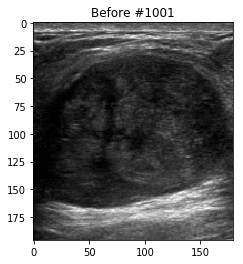

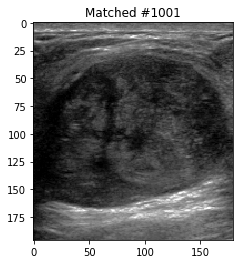

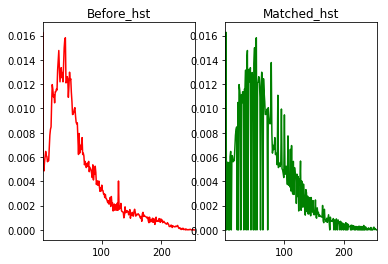

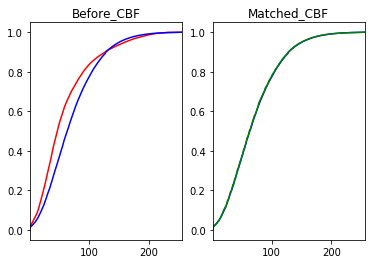

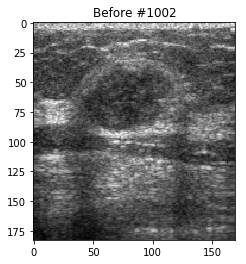

...

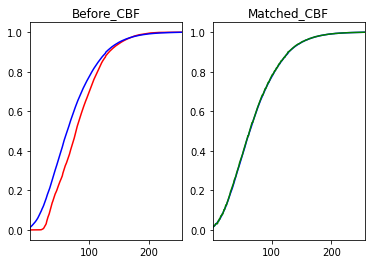

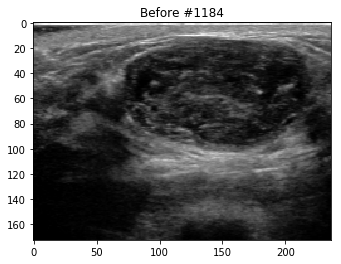

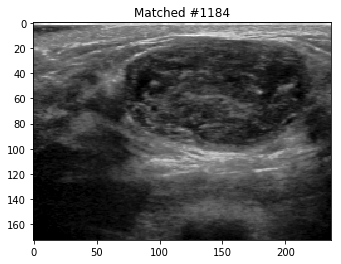

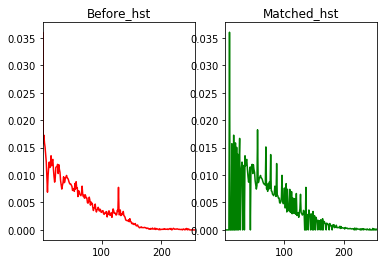

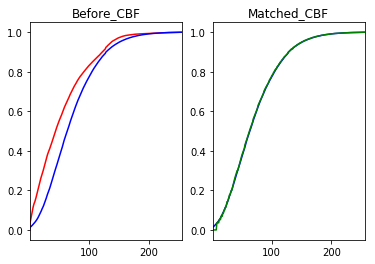

In [4]:
for i in range(1001, 1185):
    histr = 0
    img = cv2.imread('data-test/'+str(i)+'_002.tif',0)
    plt.subplot(111),plt.imshow(img,'gray'),plt.title('Before #'+str(i))
    plt.show()
    histr = cv2.calcHist([img],[0],None,[256],[0,256])/img.size
    img = cal_trans(cdf(histr), cdf_ref, img)
    histr_mod = cv2.calcHist([img],[0],None,[256],[0,256])/img.size
    plt.subplot(111),plt.imshow(img,'gray'),plt.title('Matched #'+str(i))
    plt.show()
    plt.subplot(121),plt.plot(histr,color='r'),plt.title('Before_hst'),plt.xlim([1,256])
    plt.subplot(122),plt.plot(histr_mod,color='g'),plt.title('Matched_hst'),plt.xlim([1,256])
    plt.show()
    plt.subplot(121),plt.plot(cdf(histr),color='r'),plt.plot(cdf_ref,color='b'),plt.title('Before_CBF'),plt.xlim([1,256])
    plt.subplot(122),plt.plot(cdf_ref,color='b'),plt.plot(cdf(histr_mod),color='g'),plt.title('Matched_CBF'),plt.xlim([1,256])
    plt.show()